# Jamming Avoidance Response in Weakly Electric Fish

In [1]:
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
import seaborn as sns; sns.set_style("white")
plt.rcParams["animation.html"] = "jshtml"
from celluloid import Camera #for creating a gif of time-varying field

## Single Fish
Number of poles

In [2]:
n = 200

Location of the poles

In [3]:
y_p = np.arange(-10,10,20/n)
x_p = np.zeros(np.size(y_p))

Model parameters

In [4]:
m = n-1
q = 8

Evaluate model

In [5]:
def generate(m, q, x_p, y_p, lim=20, res=0.05):
    #generate grid
    x = np.arange(-lim, lim, res)
    y = np.arange(-lim, lim, res)
    xx, yy = np.meshgrid(x, y, sparse=True)
    
    #vectorize the positions
    if np.size(np.shape(x_p))<2: x_p = np.array([x_p])
    if np.size(np.shape(y_p))<2: y_p = np.array([y_p])
        
    #vectorize q
    if np.size(np.shape(q))<1: q = np.array([q])
        
    N = np.shape(x_p)[0]
    
    #evaluate model
    t1 = np.zeros([np.size(xx),np.size(yy)])
    t2 = np.zeros([np.size(xx),np.size(yy)])
    for p in range(N): #loop over number of fish
        for i in range(m): #loop over +ve poles
            t1 += (q[p]/m)/np.sqrt(((xx-x_p[p][i])**2)+((yy-y_p[p][i])**2))
        for j in range(m,n): #loop over -ve poles
            t2 += (q[p]/(n-m))/np.sqrt(((xx-x_p[p][j])**2)+((yy-y_p[p][j])**2))
    return t1-t2

In [6]:
V = generate(m, q, x_p,y_p)
Ex,Ey = np.gradient(V); Ex= -Ex; Ey= -Ey

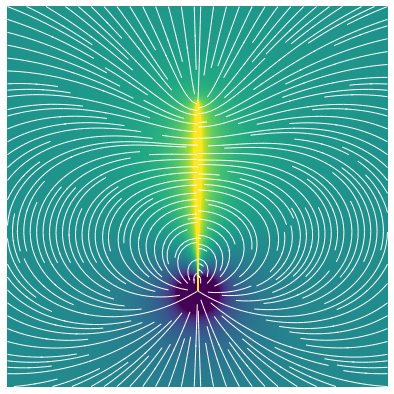

In [7]:
plt.figure(figsize = (7,7))
plt.imshow(V,vmin=-2.5,vmax=2.5,cmap='viridis')
plt.streamplot(np.arange(0,np.shape(V)[1]), np.arange(0,np.shape(V)[0]), Ey, Ex, color = 'w', linewidth = 1, 
               density = 2, arrowstyle = '-')
plt.axis('off');
plt.savefig("electric_field_1_fish.png",dpi=500)

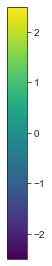

In [8]:
my_map = sns.color_palette("viridis",as_cmap=True)
import matplotlib as mpl

fig = plt.figure(figsize=(0.3,35))
ax = fig.add_axes([0.05, 0.80, 0.9, 0.1])

cb = mpl.colorbar.ColorbarBase(ax, orientation='vertical', 
                               cmap=my_map,
                               norm=mpl.colors.Normalize(-2.5, 2.5))
plt.savefig('volt_colorbar',dpi=500,bbox_inches='tight')

## Double Fish

In [9]:
n = 200 #per fish

In [10]:
#fish 1
y_p1 = np.arange(-14,6,20/n)
x_p1 = np.arange(-8.5,-5.5,3/n)

#fish 2
y_p2 = np.arange(-10,10,20/n)
x_p2 = np.ones(np.size(y_p2))*(6)

#combine
x_p = np.array([x_p1,x_p2])
y_p = np.array([y_p1,y_p2])

In [11]:
m = n-1
q = np.array([8,8]) #same for both fish

In [12]:
V = generate(m, q, x_p, y_p)
Ex,Ey = np.gradient(V); Ex= -Ex; Ey= -Ey

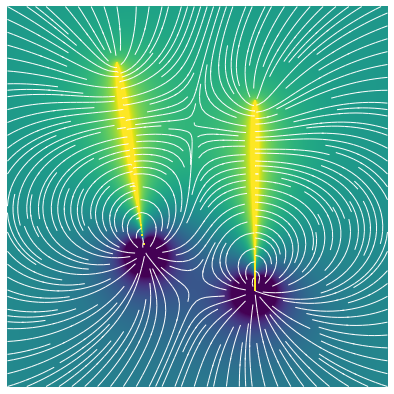

In [13]:
plt.figure(figsize = (7,7))
plt.imshow(V,vmin=-2.5,vmax=2.5,cmap='viridis')
plt.streamplot(np.arange(0,np.shape(V)[1]), np.arange(0,np.shape(V)[0]), Ey, Ex, color = 'w', linewidth = 1, 
               density = 2, arrowstyle = '-')
plt.axis('off');
plt.savefig("electric_field_2_fish.png",dpi=500)

## Sinusoidally Varying Field
$q$ varies sinusoidally over time.

In [14]:
n = 200
m = n-1
w = 250*(2*np.pi)
t = np.arange(0.10,0.12,0.0004)
q = 8*np.cos(w*t)

y_p = np.array([np.arange(-10,10,20/n)])
x_p = np.array([np.zeros(np.size(y_p))])

In [15]:
fig = plt.figure(figsize = (4.5,4.5))
camera = Camera(fig)
for k in q:
    V = generate(m, k, x_p, y_p)
    Ex,Ey = np.gradient(V); Ex= -Ex; Ey= -Ey
    plt.imshow(V,vmin=-2.5,vmax=2.5,cmap='viridis')
    plt.streamplot(np.arange(0,np.shape(V)[1]), np.arange(0,np.shape(V)[0]), Ey, Ex, color = 'w', linewidth = 0.5, 
               density = 1, arrowstyle = '-')
    plt.axis('off')
    plt.text(200, 400, "250 Hz", fontsize=12, color='w')
    plt.text(500, 50, "slowed: 0.004x", fontsize=12, color='w')
    camera.snap()
plt.close()

In [16]:
animation = camera.animate()
animation.save("time_varying_single_fish.mp4",fps = 10,dpi=100)
animation

# Interference

In [17]:
n = 200
m = n-1

t = np.arange(0.10,0.15,0.0004)

w1 = 250*(2*np.pi)
q1 = 8*np.cos(w1*t)

w2 = 254*(2*np.pi)
q2 = 8*np.cos(w2*t)

#fish 1
y_p1 = np.arange(-10,10,20/n)
x_p1 = np.ones(np.size(y_p1))*(-4)

#fish 2
y_p2 = np.arange(-10,10,20/n)
x_p2 = np.ones(np.size(y_p2))*(4)

#combine
x_p = np.array([x_p1,x_p2])
y_p = np.array([y_p1,y_p2])
q = np.array([q1,q2]).T

In [18]:
fig = plt.figure(figsize = (4.5,4.5))
camera = Camera(fig)
for k in q:
    V = generate(m, k, x_p, y_p)
    Ex,Ey = np.gradient(V); Ex= -Ex; Ey= -Ey
    plt.imshow(V,vmin=-2.5,vmax=2.5,cmap='viridis')
    plt.streamplot(np.arange(0,np.shape(V)[1]), np.arange(0,np.shape(V)[0]), Ey, Ex, color = 'w', linewidth = 0.5, 
               density = 1, arrowstyle = '-')
    plt.text(80, 400, "250 Hz", fontsize=12, color='w')
    plt.text(600, 400, "254 Hz", fontsize=12, color='w')
    plt.text(500, 50, "slowed: 0.004x", fontsize=12, color='w')
    plt.axis('off')
    camera.snap()
plt.close()

In [19]:
animation = camera.animate()
animation.save("time_varying_interfering_fish.mp4",fps = 10,dpi=100)
animation

# JAR

In [20]:
n = 200
m = n-1

t = np.arange(0.10,0.15,0.0004)

w1 = 244*(2*np.pi)
q1 = 8*np.cos(w1*t)

w2 = 264*(2*np.pi)
q2 = 8*np.cos(w2*t)

#fish 1
y_p1 = np.arange(-10,10,20/n)
x_p1 = np.ones(np.size(y_p1))*(-4)

#fish 2
y_p2 = np.arange(-10,10,20/n)
x_p2 = np.ones(np.size(y_p2))*(4)

#combine
x_p = np.array([x_p1,x_p2])
y_p = np.array([y_p1,y_p2])
q = np.array([q1,q2]).T

In [21]:
fig = plt.figure(figsize = (4.5,4.5))
camera = Camera(fig)
for k in q:
    V = generate(m, k, x_p, y_p)
    Ex,Ey = np.gradient(V); Ex= -Ex; Ey= -Ey
    plt.imshow(V,vmin=-2.5,vmax=2.5,cmap='viridis')
    plt.streamplot(np.arange(0,np.shape(V)[1]), np.arange(0,np.shape(V)[0]), Ey, Ex, color = 'w', linewidth = 0.5, 
               density = 1, arrowstyle = '-')
    plt.text(80, 400, "244 Hz", fontsize=12, color='w')
    plt.text(600, 400, "264 Hz", fontsize=12, color='w')
    plt.text(500, 50, "slowed: 0.004x", fontsize=12, color='w')
    plt.axis('off')
    camera.snap()
plt.close()

In [22]:
animation = camera.animate()
animation.save("time_varying_JARing_fish.mp4",fps = 10,dpi=100)
animation